# Reconstructing Audio

## by Zen Yoshida 

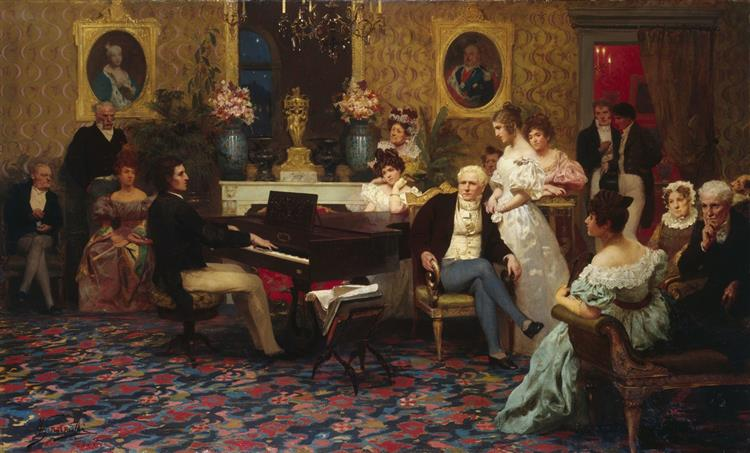

In [4]:
from IPython.display import Image, display
image_path = r"C:\Users\zyosh\Downloads\chopin-playing-the-piano-in-prince-radziwill-s-salon-1887.jpg"
display(Image(filename=image_path, width=400))


*Chopin Playing the Piano in Prince Radziwill's Salon (1887) by Henryk Siemiradzki. I am a huge fan of Frederick Chopin's music. What is your favorite?*

### Abstract

This project delves into the exploration of audio signal reconstruction using the Discrete Cosine Transform (DCT) and analyzes the effects of compression on audio data. The primary objectives include loading and understanding the provided audio signal matrix, FPP_DATA.mat, playing it, and then applying DCT. We then reconstruct the signal fromcoefficients, and evaluate the impact of compression. The project also involves implementing a filtering mechanism based on several thresholds and assessing the quality of compressed signals.

The results are useful in providing insights into the trade-offs between compression levels and audio quality. This project hopes to teach basic methodologies in audio signal processing, compression techniques, and the evaluation of reconstructed signals.

### Section 1: Loading and Playing the Audio

i) A datafile titled FPP_DATA.mat was provided to load and play. The data contains a signal matrix x which holds the signal values for both left and right channels of the audio file. Below is a chart visualizing how they look over the duration of the clip.

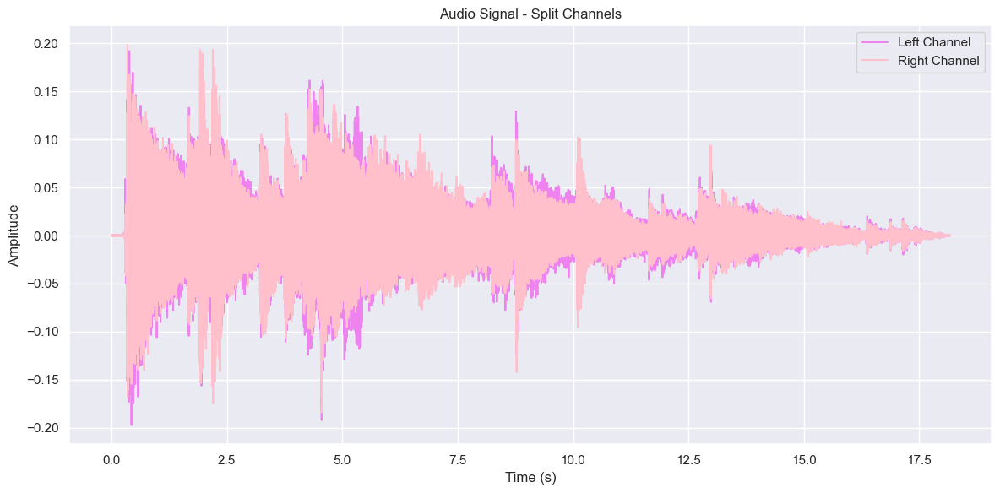

In [6]:
import seaborn as sns
import scipy.io
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

data = scipy.io.loadmat('FPP_DATA.mat')
x = data['x']

Fs = 44100
time = np.arange(0, x.shape[0]) / Fs

df = pd.DataFrame(x, columns=['Left Channel', 'Right Channel'])
df['Time (s)'] = time

sns.set(style="darkgrid")
plt.figure(figsize=(12, 6))
sns.lineplot(x='Time (s)', y='Left Channel', data=df, label='Left Channel', color='violet')
sns.lineplot(x='Time (s)', y='Right Channel', data=df, label='Right Channel', color='pink')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Audio Signal - Split Channels')
plt.legend()
plt.tight_layout()
plt.show()


Each row of the matrix corresponds to a specific point in time, measured in seconds, and the columns contain the signal values for the left and right. The dimension of $x$ is:

In [8]:

print("Dimension of x:", x.shape)


Dimension of x: (800791, 2)


 ii) IPython.display was utilized to play 'FPP.wav' in Jupyter. SimpleAudio ran into issues with installation. 

In [10]:
from scipy.io import wavfile
import numpy as np
from IPython.display import Audio

Fs = 44100 # Sample rate in hertz (Hz)
scale = 1/np.max(np.abs(x)) * 32767
wavfile.write("FPP.wav", Fs, (x*scale).astype(np.int16))

Audio("FPP.wav")


### Section 2a: DCT and my_filter

#### - What is DCT?

 i) The [Discrete Cosine Transformation](https://en.wikipedia.org/wiki/Discrete_cosine_transform), or DCT for short, is a mathematical transform widely used in signal processing and data compression problems. The DCT transforms a sequence of data points, into a set of coefficients that represent the signal in terms of cosine functions of differering frequencies.

There are several types of DCT, labeled from type I to type IV, each with its specific mathematical formulation. Type II DCT is the most commonly used in applications such as JPEG image compression and MP3 audio compression.

In the context of this project, we are using the type 2 DCT function (scipy.fftpack.dct) to find the coefficients of the representation of an audio signal $x$ using orthogonal discrete cosine vectors. These coefficients can then be used for various signal processing and compression purposes.

In [11]:
from scipy.fftpack import dct
a = dct(x, type=2, axis=0, norm='ortho')

 ii) The relative error between x and x0, defined as the average of relative errors in left and right
channels, is displayed as:


${relerr}(x, x_0) = \frac{1}{2} \left( \frac{\lVert x[:, 0] - x_0[:, 0] \rVert_2}{\lVert x[:, 0] \rVert_2} + \frac{\lVert x[:, 1] - x_0[:, 1] \rVert_2}{\lVert x[:, 1] \rVert_2} \right)$


Applying this to the two channels results in the relative error between $x$ and $x_0$.

In [12]:
from scipy.fftpack import idct
import numpy as np


x0 = idct(a, type=2, axis=0, norm='ortho')
relative_error_left = np.linalg.norm(x[:, 0] - x0[:, 0]) / np.linalg.norm(x[:, 0])
relative_error_right = np.linalg.norm(x[:, 1] - x0[:, 1]) / np.linalg.norm(x[:, 1])
average_relative_error = 0.5 * (relative_error_left + relative_error_right)

print("Relative Error:", average_relative_error)


Relative Error: 1.0641060075808064e-15


 iii) Note the slight difference between relative errors despite not yet compressing any data. This is due to the Discrete Cosine Transformation being what is called a [Lossy Compression or Transformation](https://www.khanacademy.org/computing/computers-and-internet/xcae6f4a7ff015e7d:digital-information/xcae6f4a7ff015e7d:data-compression/a/lossy-compression). Some information is discarded or approximated during the transformation, leading to a loss of fidelity. The DCT represents the original signal using a set of cosine functions, and during the reconstruction process, some high-frequency outliers may be lost, leading to a small but real deviation. Furthermore, for the sake of the project the audio was pre-compressed to 16-bit integer, which may further introduce quantization errors and the possibility for differences to arise.

In [13]:
def my_filter(a, th):
    """
    Given the coefficient a of a signal x and a threshold,
    compute the coefficient after filtering values smaller than the threshold.

    INPUT:
    - a: coefficients of the DCT representation of signal x
    - th: threshold to be used for filtering values of a

    OUTPUT:
    - ath: filtered coefficients
    """
    # Make a copy of the input coefficients to avoid altering the original.
    ath = a.copy()

    # Apply the thresholding condition. We want the absolute value because the DCT can be negative,
    # and thus must be ensured we capture those values as well.
    ath[np.abs(ath) < th] = 0

    return ath


 iv) Utilizing the DCT, we can now develop a my_filter function. This function is designed to perform a thresholding operation on the coefficients of the DCT. Given the DCT coefficients $a$ and a specified threshold $th$, the function produces a filtered set of coefficients denoted as $ath$. Written simply my_filter satisfies the desired condition of:

${ath}_{ij} = \begin{cases} 
0, & \text{if } |a_{ij}| < {th} \\
a_{ij}, & \text{if } |a_{ij}| \geq{th}
\end{cases}$

An example of the methodology, which applies $a$ to a $th$ of 0.008 is shown below:


In [14]:
filtered_coefficients = my_filter(a, 0.008)
print(filtered_coefficients[:5])

[[ 0.         -0.02053485]
 [ 0.         -0.018716  ]
 [ 0.02588162  0.        ]
 [ 0.04220241  0.04140729]
 [ 0.00904758  0.06741425]]


The resulting matrix contains DCT coefficients where values with magnitudes less than 0.008 are set to zero, while values with magnitudes greater than or equal to 0.008 retain their original values. The first column indicates the DCT coefficient for the left channel and the second column for the right channel.

In [15]:

# The given threshold values
thresholds = [0.5, 0.1, 0.01, 0.001, 0.0001]

# Make new lists
filtered_coefficients = []
reconstructed_signals = []

# Apply my_filter
for th in thresholds:
    ath = my_filter(a, th)
    filtered_coefficients.append(ath)

    x_reconstructed = idct(ath, type=2, axis=0, norm='ortho')
    reconstructed_signals.append(x_reconstructed)

# Create coefficient matrices and signals
a5, a1, a01, a001, a0001 = filtered_coefficients
x5, x1, x01, x001, x0001 = reconstructed_signals


### Section 2b: my_metrics

 i) We will now establish a my_metrics function to quantify the effectiveness of signal compression by calculating critical metrics. The values we will use are:
 
x: Original signal matrix and its Discrete Cosine Transform coefficients 

a: Discrete Cosine Transform coefficients 

y: Compressed signal matrix

b: Compressed signal coefficients

By doing this, our hope is to be able to evaluate the average relative error in the signal reconstruction, the average relative error in the DCT coefficients, and the compression ratio. The compression ratio represents the level of compression achieved, reflecting the reduction in non-essential information.

In [16]:
def my_metrics(x, a, y, b):
    """
    Calculate relative errors and compression ratio for a signal and its compressed version.

    Input:
    • x = original signal matrix x
    • a = coefficients of the DCT representation of signal x
    • y = compressed signal matrix y
    • b = coefficients for the compressed signal y

    Output:
    • rel_err: Relative error in signal
    • rel_err_a: Relative error in coefficients
    • comp_ratio: Compression ratio
    """
    # relative error in signal
    rel_err_left = np.linalg.norm(x[:, 0] - y[:, 0]) / np.linalg.norm(x[:, 0])
    rel_err_right = np.linalg.norm(x[:, 1] - y[:, 1]) / np.linalg.norm(x[:, 1])
    rel_err = 0.5 * (rel_err_left + rel_err_right)

    # relative error in coefficients
    rel_err_a_left = np.linalg.norm(a[:, 0] - b[:, 0]) / np.linalg.norm(a[:, 0])
    rel_err_a_right = np.linalg.norm(a[:, 1] - b[:, 1]) / np.linalg.norm(a[:, 1])
    rel_err_a = 0.5 * (rel_err_a_left + rel_err_a_right)

    # comp ratio
    comp_ratio = np.count_nonzero(b) / np.count_nonzero(a)
    return rel_err, rel_err_a, comp_ratio

# loop through for readability
for i, th in enumerate(thresholds[:-1]):
    print(f"\nResults for Threshold = {th}:")
    rel_err, rel_err_a, comp_ratio = my_metrics(x, a, reconstructed_signals[i], filtered_coefficients[i])
    print("Relative Error in Signal:", rel_err)
    print("Relative Error in Coefficients:", rel_err_a)
    print("Compression Ratio:", comp_ratio)



Results for Threshold = 0.5:
Relative Error in Signal: 0.6396166721258945
Relative Error in Coefficients: 0.6396166721258945
Compression Ratio: 0.00024725552609857

Results for Threshold = 0.1:
Relative Error in Signal: 0.3270276564533916
Relative Error in Coefficients: 0.3270276564533916
Compression Ratio: 0.0050250315001042715

Results for Threshold = 0.01:
Relative Error in Signal: 0.08842189108744387
Relative Error in Coefficients: 0.08842189108744387
Compression Ratio: 0.06621890106157537

Results for Threshold = 0.001:
Relative Error in Signal: 0.011406008483669666
Relative Error in Coefficients: 0.011406008483669669
Compression Ratio: 0.46556092663379084


ii) As expected, a lower threshold value results in much better relative errors relative to the rest. However, the compression ratio even for the best threshold here is still 0.46556, or less than 50%. The compression ratio of 47% signifies an that less than half of the original was retained during compression. It will be curious to see how it sounds. I also found it intriguing that the relative errors in the signal and coefficients is the same for 0.5, 0.1, and 0.01, and only at 0.001 does there appear to be the tiniest of differences. Now, let's finally take a listen to the four.

In [18]:
#i)

from scipy.io import wavfile
import numpy as np
from IPython.display import Audio

# use the reconstructed_singals list to now loop thru and provide audio clip
for i, th in enumerate(thresholds[:-1]):
    filename = f"compsig_{i}.wav"
    scale = 1 / np.max(np.abs(reconstructed_signals[i])) * 32767
    wavfile.write(filename, Fs, (reconstructed_signals[i] * scale).astype(np.int16))
    display(Audio(filename))

### Section 3: Results

| Threshold Value | Relative Error in Signal | Relative Error in Coefficients | Compression Ratio | Space Savings | Similar Sound |
|------------------|--------------------------|---------------------------------|---------------------|---------------|---------------|
| 0.5              | 0.6396                   | 0.6396                          | 0.00025             | 0.99975       | False         |
| 0.1              | 0.3270                   | 0.3270                          | 0.00503             | 0.99497       | False          |
| 0.01             | 0.0884                   | 0.0884                          | 0.06622             | 0.93378       | True          |
| 0.001            | 0.0114                   | 0.0114                          | 0.46556             | 0.53444       | True         |


i) The 0.5 threshold value sounds abysmally poor. It sounds like an AI generated attempt of meditation music from YouTube!


ii) At 0.1, you can now hear the notes attempt to change and form the melody. It still sounds like a sludgy blend of noise, so I did not think it sounded similar enough to count towards the column.


iii) With 0.01, there is a raspy sound that plays through the entire audio. The piano sounds rather out of tune, and the higher pitched notes are very unpleasant. However, it sounds less like a mess of noise and distinct elements of the audio can be pointed out, such as the beginning of the lyrics. This is certainly recognizable to be the original.

iv) I was pretty surprised at 0.001. Despite the only a 47% compression ratio, the reconstruction sounds remarkably similar to the original. From a human's perspective, I would have guessed it was well over 80% identical! There is just a faint raspy sound that lasts in the background like the previous one.

### Section 4: Bonus

#### - Does 0.0001 Sound Perfect?
i) If 0.001 sounded really close to the original, would 0.0001 be enough to have the difference no longer be detectable by someone musically uninclined like myself?

In [20]:

print("\nResults for x0001:")
print("Relative Error in Signal:", rel_err)
rel_err, rel_err_a, comp_ratio = my_metrics(x, a, reconstructed_signals[4], filtered_coefficients[4])
print("Relative Error in Coefficients:", rel_err_a)
print("Compression Ratio:", comp_ratio)



Results for x0001:
Relative Error in Signal: 0.011406008483669666
Relative Error in Coefficients: 0.0006942895366683092
Compression Ratio: 0.7090183331231245


Let's see if a C- grade for the compression ratio, 70.9%, is convincing enough.

In [22]:

scale_x0001 = 1 / np.max(np.abs(x0001)) * 32767
wavfile.write("compsig_x0001.wav", Fs, (x0001 * scale_x0001).astype(np.int16))

display(Audio("compsig_x0001.wav", rate=Fs))


| Threshold Value | Relative Error in Signal | Relative Error in Coefficients | Compression Ratio | Space Savings | Similar Sound |
|------------------|--------------------------|---------------------------------|---------------------|---------------|---------------|
| 0.0001            | 0.0114                   | 0.000694                      | 0.709               | 0.291         | True          |


ii) To me it sounds REALLY close to the original! There is also a slightly larger departure between relative error in signal versus coefficients. This suggests that the DCT coefficients are largely successful in mimicing the source.  The best I can say is that 0.0001 does not sound as crisp for certain instruments, especially in the cymbals, but that could easily be a placebo.

### Section 5: Summary and Conclusion



i) This project was a fun and quick dive into the exploration of audio signal reconstruction using the Discrete Cosine Transform and analyzed the effects of compression on audio data. I was able to apply DCT for signal compression for the given bit of audio and implement a filtering mechanism to measure seek varying levels of reconstruction. The my_metrics function quantified the effectiveness of signal compression by calculating critical metrics such as relative error in signal reconstruction, DCT coefficients, and the compression ratio.

The results demonstrated the relationship between compression levels and audio quality, highlighting the impact of different threshold values on the reconstructed signal. While the 0.5 threshold sounded absolutely nothing like the original, by 0.01 it was clear enough that the reconstruction was effective. Interestingly, even with a modest compression ratio of 70.9%, the reconstructed signal at a threshold of 0.0001 sounded remarkably close to the base, showcasing the powerful capabilities of the DCT-based compression approach. Overall, The project was a great insight into basic methodologies in audio signal processing, compression techniques, and the evaluation of reconstructed signals.

### Section 6: References

"Discrete Cosine Transform." Wikipedia, The Free Encyclopedia, 8 Dec. 2023, https://en.wikipedia.org/wiki/Discrete_cosine_transform.

Khan Academy. "Lossy Compression." Khan Academy, https://www.khanacademy.org/computing/computers-and-internet/xcae6f4a7ff015e7d:digital-information/xcae6f4a7ff015e7d:data-compression/a/lossy-compression.